In [1]:
from data_tools import *

In [2]:
# from matplotlib import pyplot as plt
from PIL import Image
import cv2 as cv
import numpy as np
import itertools
import scipy.ndimage
# import seaborn as sns
# import pandas as pd
from pathlib import Path
from tqdm import tqdm as tqdm
from distutils import dir_util
%config InlineBackend.figure_format = 'retina'
Image.MAX_IMAGE_PIXELS = None

# Prepare data and apply segmentation 

In [3]:
sample_dir = 'mouse_brain_602' # dir for image tiles
full_img_path = 'mouse_brains/mouse_brain_he_Library_028_C05717_020_D1_144601.jpg'
network_dir = '/home/yubi/Downloads1/dsb2018_topcoders/' 

In [4]:
network_dir = Path(network_dir)

In [5]:
full_img = cv.imread(full_img_path, -1)

In [ ]:
plt.imshow(full_img[3500:16000, 6000:19500])

In [20]:
#600 [3500:16000, 6000:19500]
#601 [2000:16000, 7500:22000]

In [9]:
tiles, tile_names = split_image(img=full_img[3500:16000, 6000:19500], x_tile_size=1000, y_tile_size=1000)

In [5]:
prepare_test_data(tiles, tile_names, sample_dir)

NameError: name 'tiles' is not defined

In [19]:
try:
    dir_util.remove_tree(str(network_dir/'data_test'))
except:
    pass
os.mkdir(str(network_dir/'data_test'))
dir_util.copy_tree(sample_dir, str(network_dir/'data_test'));

In [20]:
try:
    dir_util.remove_tree(str(network_dir/'predictions'))
except:
    pass

try:
    dir_util.remove_tree(str(network_dir/'albu/result_test'))
except:
    pass

In [14]:
! cd {network_dir} && bash 'predict_test.sh'

~/Downloads1/dsb2018_topcoders/selim ~/Downloads1/dsb2018_topcoders
Using TensorFlow backend.
OMP: Info #212: KMP_AFFINITY: decoding x2APIC ids.
OMP: Info #210: KMP_AFFINITY: Affinity capable, using global cpuid leaf 11 info
OMP: Info #154: KMP_AFFINITY: Initial OS proc set respected: 0-7
OMP: Info #156: KMP_AFFINITY: 8 available OS procs
OMP: Info #157: KMP_AFFINITY: Uniform topology
OMP: Info #179: KMP_AFFINITY: 1 packages x 4 cores/pkg x 2 threads/core (4 total cores)
OMP: Info #214: KMP_AFFINITY: OS proc to physical thread map:
OMP: Info #171: KMP_AFFINITY: OS proc 0 maps to package 0 core 0 thread 0 
OMP: Info #171: KMP_AFFINITY: OS proc 4 maps to package 0 core 0 thread 1 
OMP: Info #171: KMP_AFFINITY: OS proc 1 maps to package 0 core 1 thread 0 
OMP: Info #171: KMP_AFFINITY: OS proc 5 maps to package 0 core 1 thread 1 
OMP: Info #171: KMP_AFFINITY: OS proc 2 maps to package 0 core 2 thread 0 
OMP: Info #171: KMP_AFFINITY: OS proc 6 maps to package 0 core 2 thread 1 
OMP: Info #1

KeyboardInterrupt: 

In [16]:
dir_util.copy_tree(str(network_dir/'predictions'), 'sample_dir' + '/segmented');

# Plot some images

In [6]:
def color_tiff(img):
    img = img%60
    seg_color = np.zeros((*img.shape, 3), dtype=np.uint8)
    for i in tqdm(range(1, img.max()+1)):
        seg_color[img==i] = np.random.randint(0, 255, 3)
    return seg_color

In [7]:
seg_mask = restore_image('/home/yubi/Downloads/dsb2018_topcoders/predictions/lgbm_test_sub2/', tiff=True)

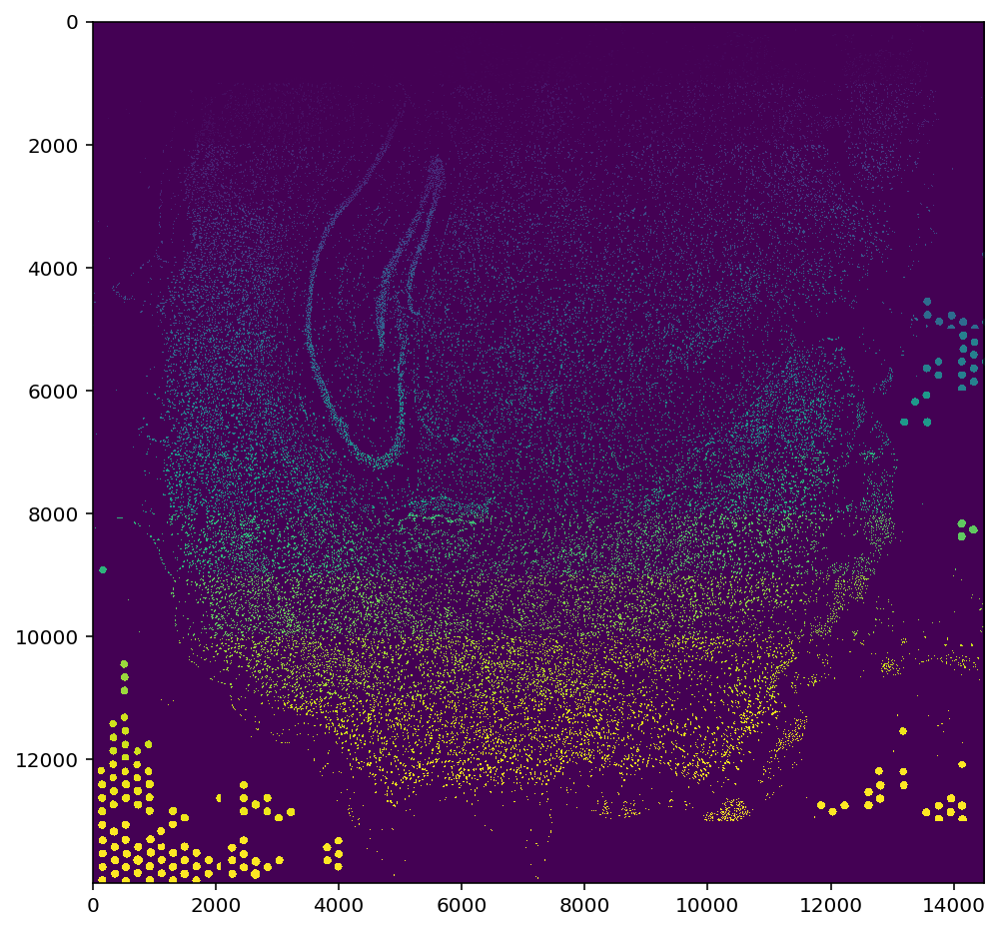

In [6]:
plt.figure(figsize=(8,8))
plt.imshow(seg_mask)

In [8]:
seg_mask_colored = color_tiff(seg_mask%60)

100%|██████████| 59/59 [01:03<00:00,  1.07s/it]


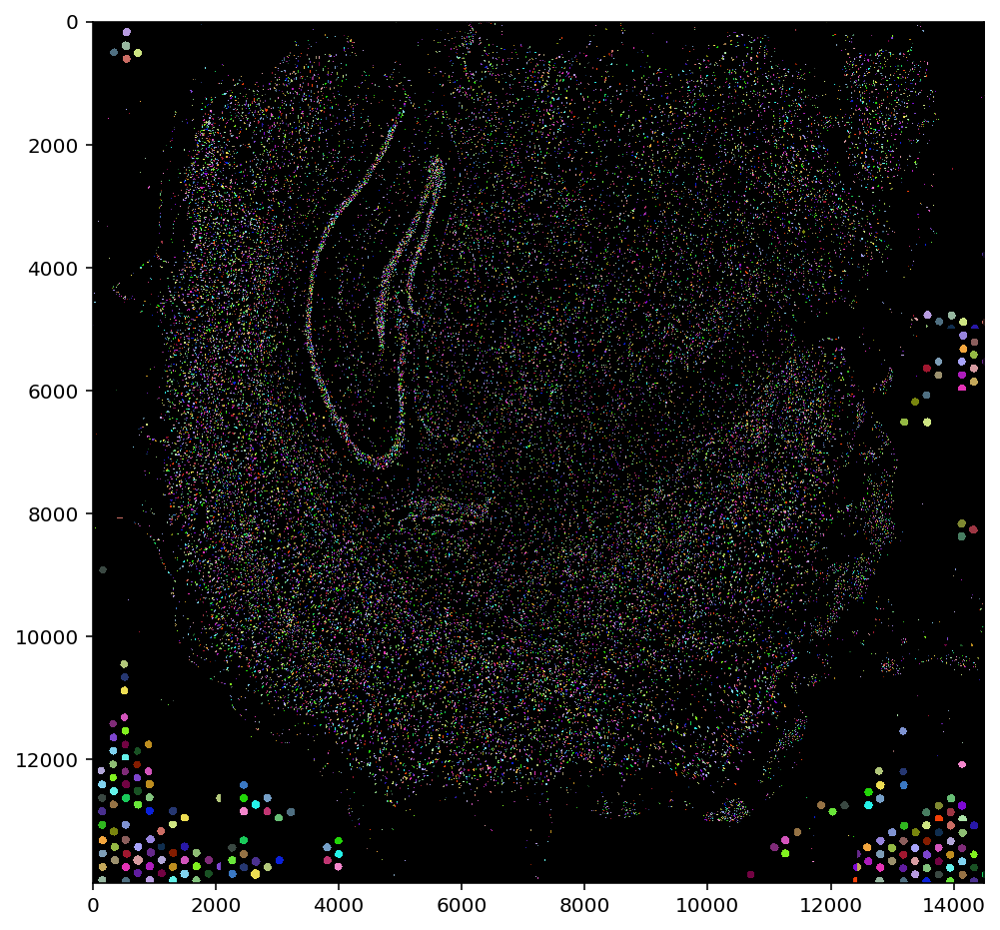

In [29]:
plt.figure(figsize=(8,8))
plt.imshow(seg_mask_colored)

In [30]:
# full_seg_mask_colored = np.zeros_like(full_img)
# full_seg_mask_colored[2000:16000, 7500:22000] = seg_mask_colored

(3000, 5000)

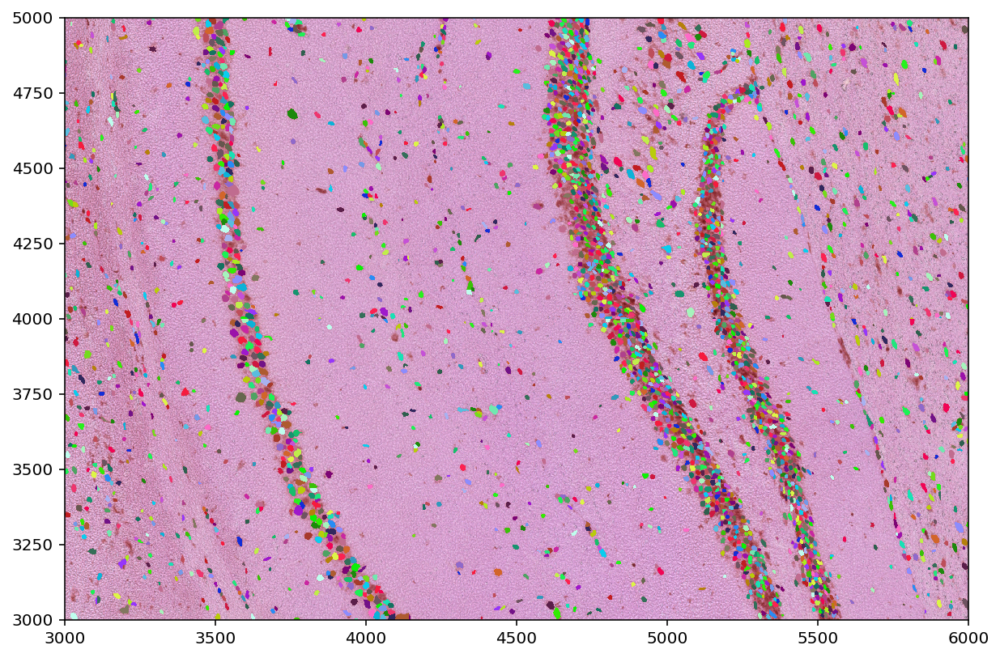

In [11]:
plt.figure(figsize=(10,10))
plt.imshow(full_img[2000:16000, 7500:22000] * (seg_mask_colored == 0) + seg_mask_colored)
plt.xlim(3000, 6000)
plt.ylim(3000, 5000)

(4200, 5100)

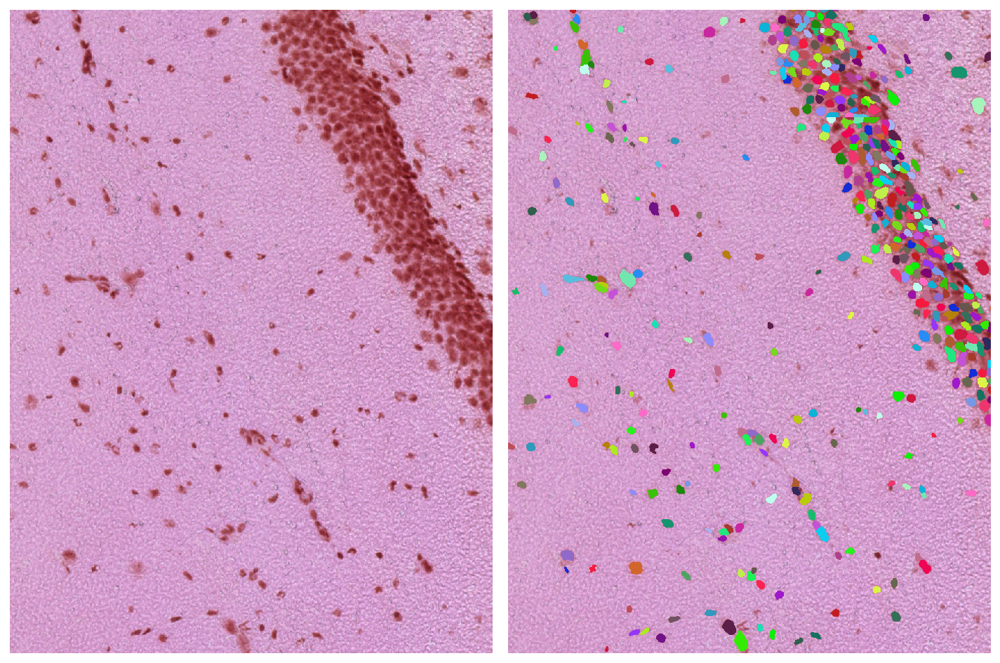

In [15]:
plt.figure(figsize=(10,10))

plt.subplot(1, 2, 1)
plt.imshow(full_img[2000:16000, 7500:22000])
plt.axis('off')

plt.ylim(3000, 4200)
plt.xlim(4200, 5100)

plt.subplot(1, 2, 2)
plt.imshow(full_img[2000:16000, 7500:22000] * (seg_mask_colored == 0) + seg_mask_colored)
plt.axis('off')

plt.tight_layout()

# plt.scatter(df['x'], df['y'], s=3, color='red')
plt.ylim(3000, 4200)
plt.xlim(4200, 5100)

# Cell morphology features 

In [121]:
import time

In [161]:
class Statistic():

    def position(self, img, **kwargs):
        x, y = scipy.ndimage.measurements.center_of_mass(img)
        x = x + self.x_min + kwargs['x_tile'] * img.shape[0]
        y = y + self.y_min  + kwargs['y_tile'] * img.shape[1]
        return [x, y]
    
    def ellips(self, img, **kwargs):
        cont = cv.findContours(img.astype(np.uint8).T.copy(), cv.RETR_EXTERNAL, cv.CHAIN_APPROX_NONE)[1][0][:, 0, :]
        ellipse_center, axles, angle = cv.fitEllipse(cont)
        x, y = ellipse_center
        x = x + self.x_min + kwargs['x_tile'] * img.shape[0]
        y = y + self.y_min  + kwargs['y_tile'] * img.shape[1]
        if axles[1] > 100:
            axles = (30, 30)
        return [*axles, x, y , angle]
    
    def size(self, img, **kwargs):
        return [img.sum()]
    

    def __init__(self, image_folder, features, x_min=0, y_min=0):
        self.image_folder = image_folder
        self.computed_features = None
        self.feature_dict = {'position': (self.position, ['x', 'y']),
                              'size': (self.size, ['size']),
                              'ellips': (self.ellips, ['first_axis', 'second_axis', 'ellipse_x', 'ellipse_y', 'ellipse_angle'])}
        if features == 'all':
            self.features = self.feature_dict.keys()
        else:
            self.features = features
        
        self.x_min = x_min
        self.y_min = y_min
    
    @property
    def feature_names(self):
        names = []
        for f in self.features:
            names += self.feature_dict[f][1]
        return names
    
    def compute(self):
        self.computed_features = []
        for filename in tqdm(os.listdir(self.image_folder)):
            img = cv.imread(f'{self.image_folder}/{filename}', -1)
            img = np.rot90(img, k=3)
            img = np.flip(img, axis=1)
            for i in range(1, img.max()):
                tmp_img = (img == i)
                tmp = []
                x_tile, y_tile = get_x_and_y(filename)
                for f in self.features:
                    tmp += self.feature_dict[f][0](tmp_img, x_tile=x_tile, y_tile=y_tile)
                self.computed_features.append(tmp)
        return self
    
    def df(self):
        if self.computed_features is None:
            self.compute()
        df = pd.DataFrame(self.computed_features, columns=self.feature_names)
        return df

In [169]:
path = '/home/yubi/Downloads/dsb2018_topcoders/predictions/lgbm_test_sub2'
df_cell = Statistic(path, features='all', x_min=7500, y_min=2000).df()





  0%|          | 0/196 [00:00<?, ?it/s]



  1%|          | 1/196 [00:05<18:37,  5.73s/it]



  1%|          | 2/196 [00:05<13:05,  4.05s/it]



  2%|▏         | 3/196 [00:07<10:51,  3.37s/it]



  2%|▏         | 4/196 [00:13<13:22,  4.18s/it]



  3%|▎         | 6/196 [00:13<09:23,  2.97s/it]



  4%|▎         | 7/196 [00:14<07:16,  2.31s/it]



  4%|▍         | 8/196 [00:18<08:44,  2.79s/it]



  5%|▍         | 9/196 [00:26<13:09,  4.22s/it]



  5%|▌         | 10/196 [00:29<12:27,  4.02s/it]



  6%|▌         | 11/196 [00:30<09:16,  3.01s/it]



  6%|▌         | 12/196 [00:30<06:37,  2.16s/it]



  7%|▋         | 13/196 [00:32<06:31,  2.14s/it]



  7%|▋         | 14/196 [00:36<07:44,  2.55s/it]



  8%|▊         | 15/196 [00:40<08:49,  2.92s/it]



  8%|▊         | 16/196 [00:41<07:25,  2.48s/it]



  9%|▊         | 17/196 [00:44<07:38,  2.56s/it]



 10%|▉         | 19/196 [00:52<08:52,  3.01s/it]



 10%|█         | 20/196 [00:55<08:40,  2.96s/it]



 11%|█         | 21/196 [

In [141]:
def draw_ellipses(img, df):
    img = img.copy()
    for x, y, a1, a2, angle in df[['ellipse_x', 'ellipse_y', 'first_axis', 'second_axis', 'ellipse_angle']].values.astype(int):
        img = cv.ellipse(img, ((x, y), (a1, a2), angle), color=(0, 255, 0))
    return img

(4000, 6000)

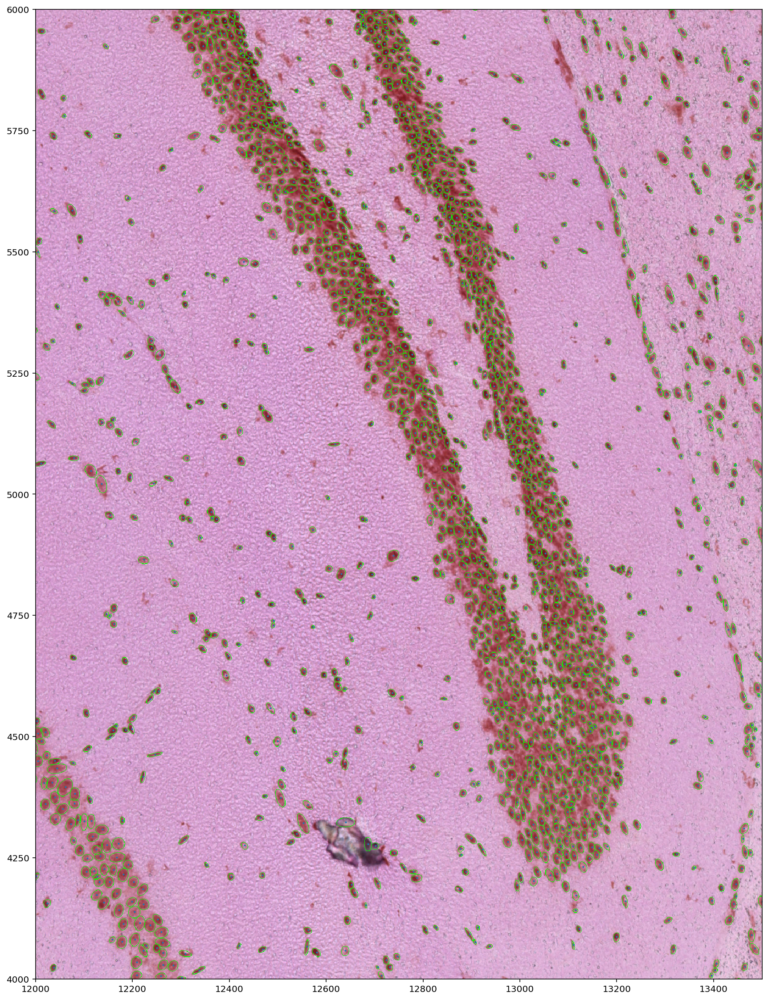

In [173]:
plt.figure(figsize=(20,20))
plt.imshow(draw_ellipses(full_img, df_cell))
plt.scatter(df_cell['x'], df_cell['y'], s=1)
plt.xlim(12000, 13500)
plt.ylim(4000, 6000)

In [24]:
#df_cell.to_csv('mouse_brains/cell_df_601_ellipse.csv', index=False)

# Dot positions

In [11]:
gray = cv.cvtColor(full_img, cv.COLOR_BGR2GRAY)

In [63]:
x_0 = 7470
y_0 = 2287
dx = 382.5
dy = 217.85

In [77]:
from itertools import product
xs = [x_0 + dx*i for i in range(39)]
ys = [y_0 + dy*i for i in range(64)]

In [78]:
coo = np.array(list(product(xs, ys)))

In [79]:
coo2 = coo + np.array([dx, -dy])/2

In [80]:
df_dot = pd.DataFrame(np.vstack((coo, coo2)), columns=['x', 'y'])

In [81]:
df_dot = df_dot.sort_values(['x', 'y'], ascending=[True, True])

In [82]:
df_dot['num'] = list(range(len(df_dot)))
df_dot['row'] = df_dot['num']//64
df_dot['col'] = df_dot['num']%64

In [83]:
df_dot['col'] = df_dot['col']*2 - df_dot['row']%2
df_dot['col'] = abs(df_dot['col'] - df_dot['col'].max())

In [86]:
from sklearn.neighbors import KDTree

tree = KDTree(df_cell[['x', 'y']].values)

df_dot['count'] = tree.query_radius(df_dot[['x', 'y']], 100, count_only=True)

In [20]:
plt.imsave('tst22.jpg', gray[:5000, :8000] < 253)

(3500, 23000)

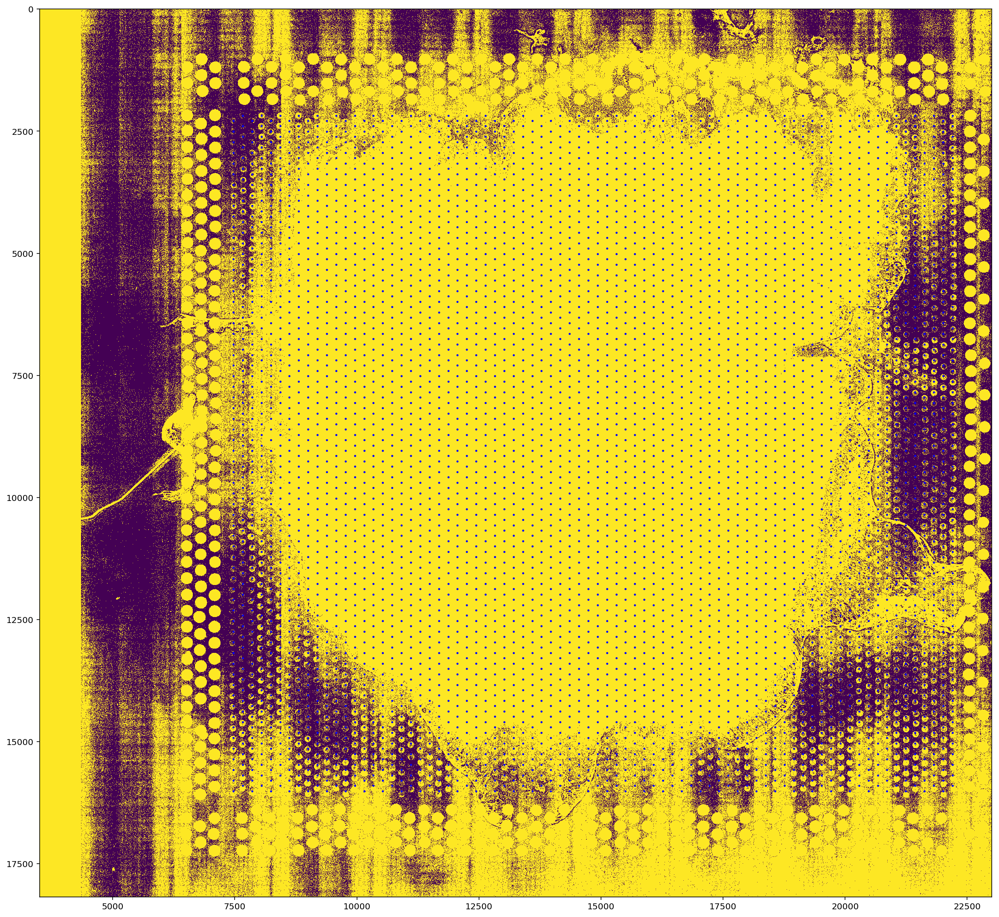

In [33]:
plt.figure(figsize=(20,20))
plt.imshow(gray < 253)
plt.scatter(coo[:, 0], coo[:, 1], s=2, color='blue')
plt.scatter(coo2[:, 0], coo2[:, 1], s=2, color='blue')
# for num, d in enumerate(df_dot.values):
#     plt.text(d[0], d[1], f'{num//64} {num%64}', size=4)
# plt.imsave('dot_mask1.png', gray[:3500, :7000] < 253)
# plt.xlim()
plt.xlim(3500, 23000)
# plt.savefig('dot_grid.png', dpi=500, bbox_inches='tight')

In [114]:
cols.head()


,spot_id,orig.ident,nCount_RNA,nFeature_RNA,sample.x,barcode,sample.y,tissue,row,col,...,archetype_30,archetype_31,archetype_32,archetype_33,archetype_34,archetype_35,archetype_36,archetype_37,archetype_38,colors
0,s144600_AAACAAGTATCTCCCA-1,s144600,14727,4575,s144600,AAACAAGTATCTCCCA-1,144600,1,50,102,...,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,grey70
1,s144600_AAACACCAATAACTGC-1,s144600,10383,3455,s144600,AAACACCAATAACTGC-1,144600,1,59,19,...,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,grey70
2,s144600_AAACAGAGCGACTCCT-1,s144600,33762,6663,s144600,AAACAGAGCGACTCCT-1,144600,1,14,94,...,0.0,0.011266,0.012035,0.000000,0.110944,0.009862,0.000000,0.042207,0.007017,grey70
3,s144600_AAACAGCTTTCAGAAG-1,s144600,8080,2986,s144600,AAACAGCTTTCAGAAG-1,144600,1,43,9,...,0.0,0.000000,0.000000,0.049529,0.000000,0.000000,0.007957,0.000000,0.000000,grey70
4,s144600_AAACAGGGTCTATATT-1,s144600,15026,4426,s144600,AAACAGGGTCTATATT-1,144600,1,47,13,...,0.0,0.000000,0.000000,0.195589,0.000000,0.003259,0.000000,0.000000,0.000000,grey70


In [44]:
import seaborn as sns

In [95]:
cols = pd.read_csv('col_data_.txt', sep='\t')

In [96]:
cols = cols[cols['sample.x']=='s144600']

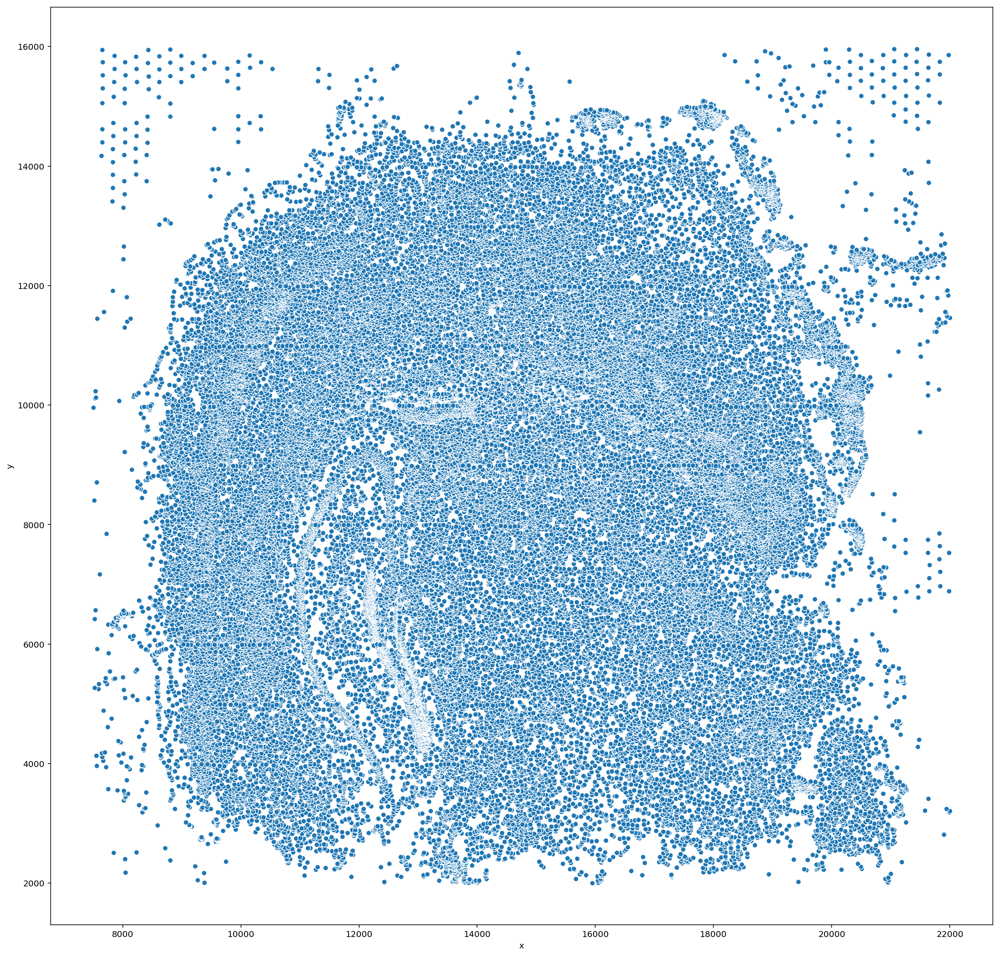

In [40]:
plt.figure(figsize=(20,20))
sns.scatterplot(x='x', y='y', data=df_cell)

In [128]:
df_dot = pd.read_csv('mouse_brains/dot_df_600.csv')
# df_dot['col'] = abs(df_dot['col'] - df_dot['col'].max())

In [93]:
df_dot.head()

,Unnamed: 0,x,y,num,row,col,count
0,0,5154.0,2294.00,0,0,126,0
1,1,5154.0,2511.85,1,0,124,0
2,2,5154.0,2729.70,2,0,122,0
3,3,5154.0,2947.55,3,0,120,0
4,4,5154.0,3165.40,4,0,118,0


In [98]:
# df_cell.to_csv('mouse_brains/cell_df_601.csv', index='False')
# df_dot.to_csv('mouse_brains/dot_df_600_aligned.csv', index='False')

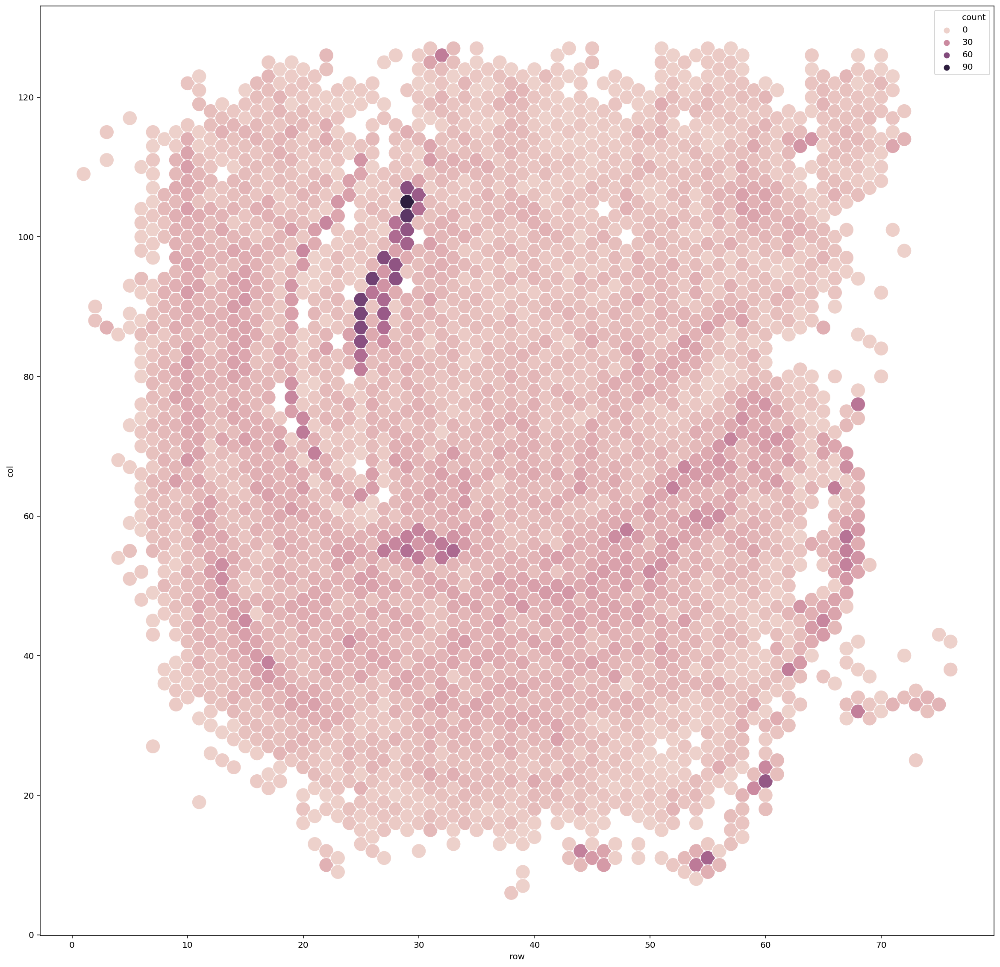

In [72]:
plt.figure(figsize=(20,20))
sns.scatterplot(x='row', y='col', data=df_dot[df_dot['count'] > 2], hue='count', s=290)
# sns.scatterplot(x='row', y='col', hue='nCount_RNA', data=cols, s=50, palette='Blues')

In [71]:
plt.figure(figsize=(20,20))
sns.scatterplot(x='row', y='col', hue='nCount_RNA', data=cols, s=270)

NameError: name 'cols' is not defined

<Figure size 1440x1440 with 0 Axes>

In [145]:
df_dot.describe()

,x,y,num,row,col,count
count,4992.000000,4992.000000,4992.000000,4992.000000,4992.000000,4992.000000
mean,12517.125000,9101.812500,2495.500000,38.500000,62.500000,7.596154
std,4306.388752,4025.104543,1441.210602,22.517065,36.952991,8.099262
min,5154.000000,2185.075000,0.000000,0.000000,-1.000000,0.000000
25%,8787.750000,5643.443750,1247.750000,19.000000,30.750000,0.000000
50%,12517.125000,9101.812500,2495.500000,38.500000,62.500000,6.000000
75%,16246.500000,12560.181250,3743.250000,58.000000,94.250000,13.000000
max,19880.250000,16018.550000,4991.000000,77.000000,126.000000,81.000000


In [5]:
from matplotlib.collections import PatchCollection
from matplotlib.patches import Circle

In [6]:
df_dot.head()

NameError: name 'df_dot' is not defined

In [ ]:
full_img.shape

In [7]:
df_dot = pd.read_csv('mouse_brains/dot_df_601_aligned.csv')

(12000, 14000)

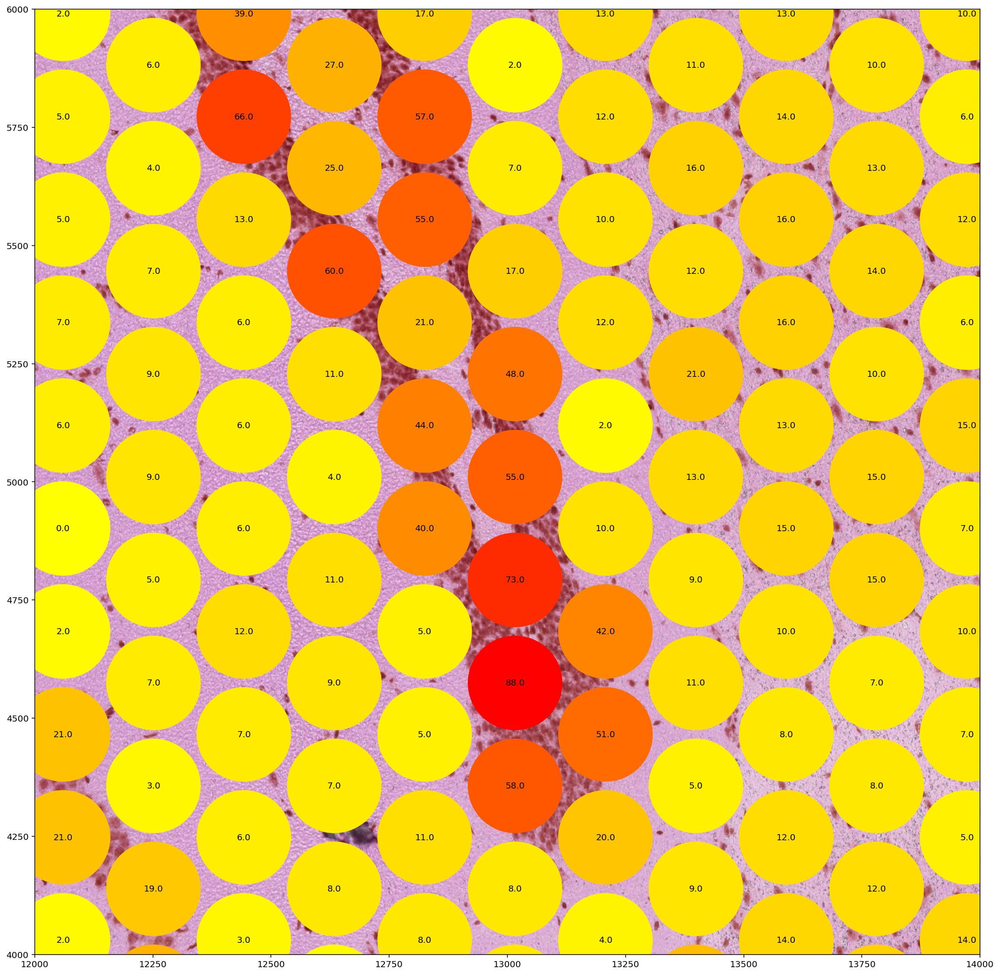

In [9]:
def get_rgb_function(cmap, min_value, max_value):
    def func(x):
        return cmap((np.clip(x, min_value, max_value)-min_value)/(max_value-min_value))
    return func

rgb_function = get_rgb_function(plt.cm.autumn_r, df_dot['count'].min(), df_dot['count'].max())

from matplotlib.collections import PatchCollection
from matplotlib.patches import Circle

fig = plt.figure(figsize=(20,20))
plt.imshow(full_img) #tissue image

for idx in df_dot.index:
    row = df_dot.loc[idx]
    dots = [Circle((x, y), 100) for x, y in [row[['x', 'y']].values]] #dot coordinates
    c = PatchCollection(dots, facecolor=rgb_function(row['count']), alpha=1, edgecolor=None)
    fig.axes[0].add_collection(c)

for x, y, t in df_dot[(df_dot.x > 12000)&(df_dot.x < 14000)&(df_dot.y > 4000)&(df_dot.y < 6000)][['x', 'y', 'count']].values:
    plt.text(x, y, str(t), horizontalalignment='center', verticalalignment='center')

plt.ylim(4000, 6000)
plt.xlim(12000, 14000)